# Eqyptian Education MatPlotLib Assignment

## imports

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

### load csv file and tranform to panda dataframe

In [2]:
csv_file = "egypt_education_dataset.csv"  
df = pd.read_csv(csv_file)

### head function to preview df

In [3]:
df.head()

,Student Name,Student Age,Student year,Father Degree,Mother Degree,Education Type,Subject_1,Subject_2,Subject_3,Subject_4,Subject_5,Subject_6,Subject_7,Subject_8,Subject_9,Subject_10
0,Allison Lang,18,Year 9,High School,High School,IB,72.236740,85.931149,65.698513,84.163844,78.179414,50.578209,70.071681,80.294509,72.709741,59.080678
1,Jaclyn Mcneil,14,Year 9,Bachelor,PhD,IB,91.603078,73.186427,64.240239,47.786542,83.138581,66.913702,42.587211,87.997009,89.176862,78.493158
2,Melissa Lee,16,Year 10,None,PhD,IB,100.000000,83.985923,89.378162,82.446853,86.368818,90.347020,100.000000,83.972296,69.212961,79.206634
3,Timothy Maxwell,14,Year 10,Bachelor,Bachelor,Thanweya,91.082131,100.000000,78.802220,78.447670,64.606239,82.045421,69.869099,91.122870,95.207752,52.602706
4,Eric Steele,17,Year 11,PhD,None,IGCSE,74.906144,69.518146,65.284841,56.317028,69.758140,85.810641,63.776955,61.802599,84.951132,68.146467


In [4]:
df.info

<bound method DataFrame.info of           Student Name  Student Age Student year Father Degree Mother Degree  \
0         Allison Lang           18       Year 9   High School   High School   
1        Jaclyn Mcneil           14       Year 9      Bachelor           PhD   
2          Melissa Lee           16      Year 10          None           PhD   
3      Timothy Maxwell           14      Year 10      Bachelor      Bachelor   
4          Eric Steele           17      Year 11           PhD          None   
...                ...          ...          ...           ...           ...   
49995     Bruce Vargas           15      Year 11          None        Master   
49996   Clarence Foley           16      Year 11          None           PhD   
49997      Dawn Palmer           14      Year 10           PhD           PhD   
49998     Albert Berry           15      Year 10           PhD      Bachelor   
49999      Amy Proctor           18      Year 12           PhD        Master   

      E

### plotting bar graph of age distribtution of students

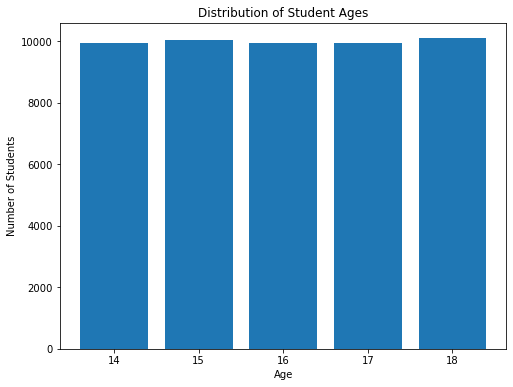

In [5]:
df['Student Age'] = df['Student Age'].astype(int)
age_counts = df['Student Age'].value_counts()

plt.figure(figsize=(8, 6))
plt.bar(age_counts.index, age_counts.values)
plt.title('Distribution of Student Ages')
plt.xlabel('Age')
plt.ylabel('Number of Students')
plt.show()

### formatting subjects

In [6]:
subjects = df.columns[7:]
subject_scores = df[subjects]
corr = subject_scores.corr()

### plot correlation map of subjects

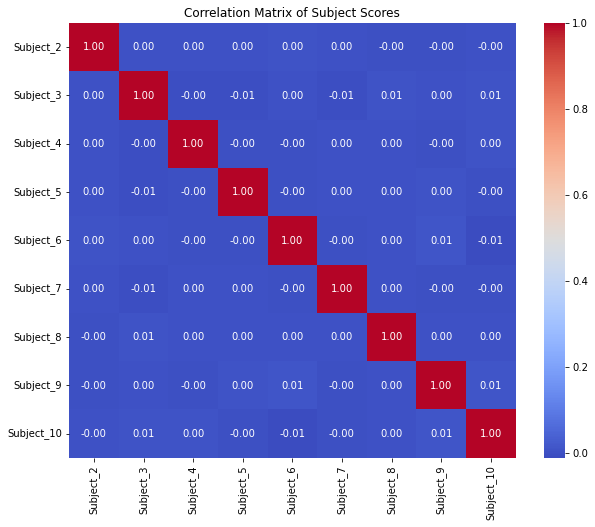

In [7]:
plt.figure(figsize=(10, 8))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix of Subject Scores')
plt.show()

### bar graph of education types

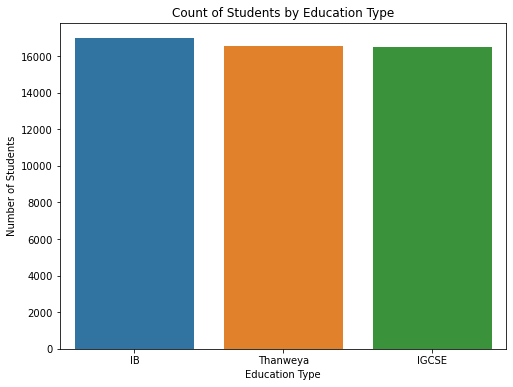

In [8]:
plt.figure(figsize=(8, 6))
sns.countplot(data=df, x='Education Type')
plt.title('Count of Students by Education Type')
plt.xlabel('Education Type')
plt.ylabel('Number of Students')
plt.show()

### scatter plot of subject 1 and 2 scores based on education type

In [9]:
fig = px.scatter(df, x='Subject_1', y='Subject_2', color='Education Type',
                 title='Subject 1 vs Subject 2 Scores by Education Type')
fig.show()

### pie chart of fathers with degress based on degree type

In [10]:
fig = px.pie(df, names='Father Degree', title='Distribution of Father Degrees')
fig.show()

### pie chart of mothers with degress based on degree type

In [11]:
fig = px.pie(df, names='Mother Degree', title='Distribution of Mother Degrees')
fig.show()

### score distribution histograms

In [12]:
df_grouped = df.groupby('Education Type').mean().reset_index()

In [14]:
fig = px.histogram(df, x='Subject_1', nbins=20, title='Distribution of Subject 1 Scores', 
                   labels={'Subject_1': 'Subject 1 Score'})
fig.show()

In [15]:
fig = px.histogram(df, x='Subject_2', nbins=20, title='Distribution of Subject 2 Scores', 
                   labels={'Subject_2': 'Subject 2 Score'})
fig.show()

In [16]:
fig = px.histogram(df, x='Subject_3', nbins=20, title='Distribution of Subject 3 Scores', 
                   labels={'Subject_3': 'Subject 3 Score'})
fig.show()

### Pair Plots between all subjects and education types

<Figure size 720x576 with 0 Axes>

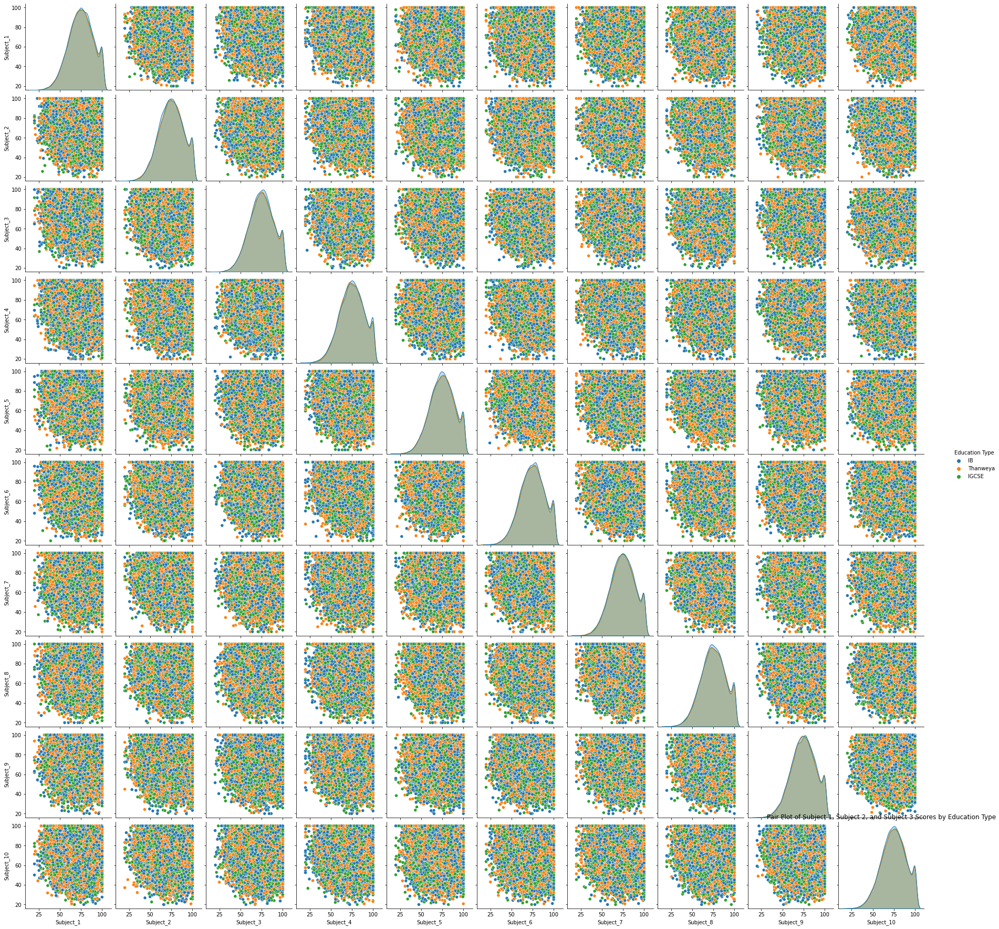

In [30]:
plt.figure(figsize=(10, 8))
sns.pairplot(df[['Subject_1', 'Subject_2', 'Subject_3', 'Subject_4', 'Subject_5', 'Subject_6', 'Subject_7', 'Subject_8', 'Subject_9', 'Subject_10','Education Type']], hue='Education Type')
plt.title('Pair Plot of Subject Scores by Education Type')
plt.show()

### Strip PLots of subjects and education Types

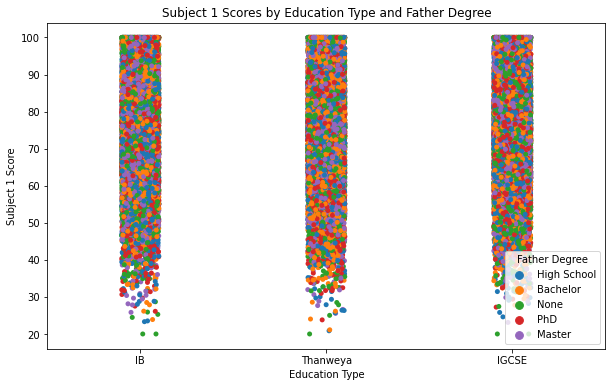

In [31]:
plt.figure(figsize=(10, 6))
sns.stripplot(data=df, x='Education Type', y='Subject_1', hue='Father Degree')
plt.title('Subject 1 Scores by Education Type and Father Degree')
plt.xlabel('Education Type')
plt.ylabel('Subject 1 Score')
plt.show()

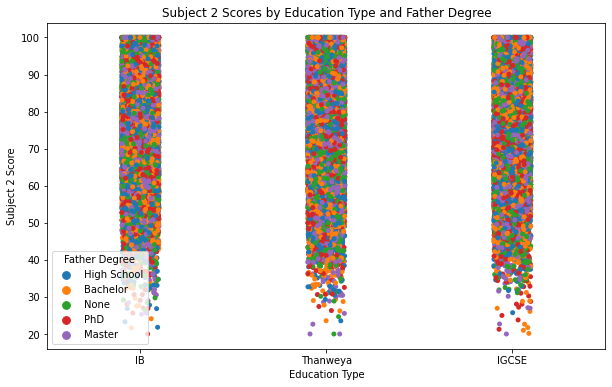

In [18]:
plt.figure(figsize=(10, 6))
sns.stripplot(data=df, x='Education Type', y='Subject_2', hue='Father Degree')
plt.title('Subject 2 Scores by Education Type and Father Degree')
plt.xlabel('Education Type')
plt.ylabel('Subject 2 Score')
plt.show()

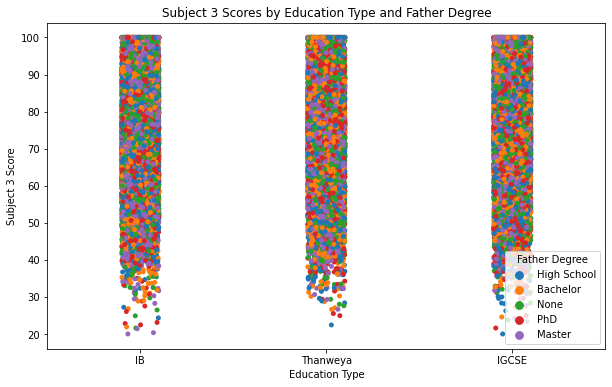

In [33]:
plt.figure(figsize=(10, 6))
sns.stripplot(data=df, x='Education Type', y='Subject_3', hue='Father Degree')
plt.title('Subject 3 Scores by Education Type and Father Degree')
plt.xlabel('Education Type')
plt.ylabel('Subject 3 Score')
plt.show()

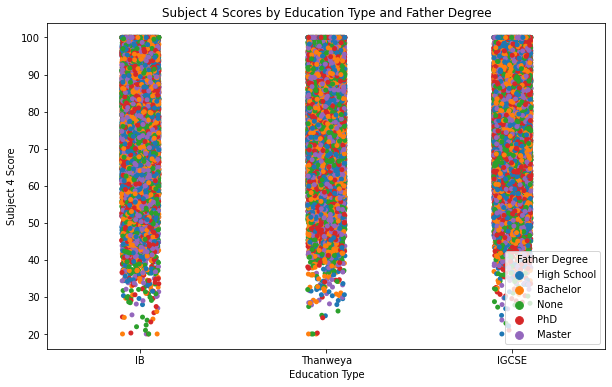

In [34]:
plt.figure(figsize=(10, 6))
sns.stripplot(data=df, x='Education Type', y='Subject_4', hue='Father Degree')
plt.title('Subject 4 Scores by Education Type and Father Degree')
plt.xlabel('Education Type')
plt.ylabel('Subject 4 Score')
plt.show()

### Bar charts of Subjects scores vs Education types

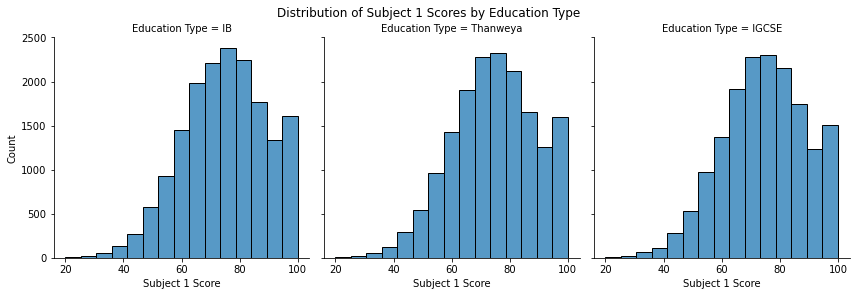

In [35]:
g = sns.FacetGrid(df, col="Education Type", height=4, aspect=1)
g.map(sns.histplot, "Subject_1", bins=15)
g.set_axis_labels('Subject 1 Score', 'Count')
g.fig.suptitle('Distribution of Subject 1 Scores by Education Type', y=1.02)
plt.show()

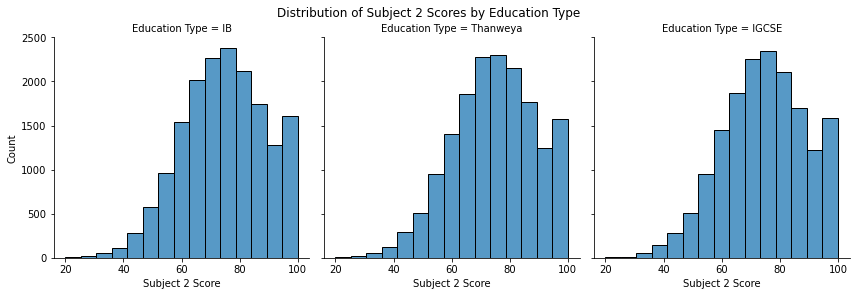

In [21]:
g = sns.FacetGrid(df, col="Education Type", height=4, aspect=1)
g.map(sns.histplot, "Subject_2", bins=15)
g.set_axis_labels('Subject 2 Score', 'Count')
g.fig.suptitle('Distribution of Subject 2 Scores by Education Type', y=1.02)
plt.show()

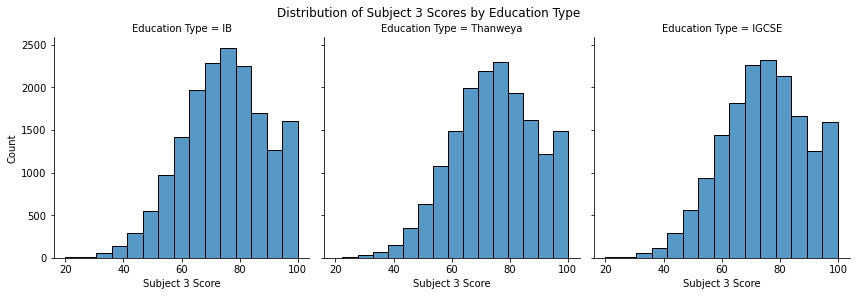

In [22]:
g = sns.FacetGrid(df, col="Education Type", height=4, aspect=1)
g.map(sns.histplot, "Subject_3", bins=15)
g.set_axis_labels('Subject 3 Score', 'Count')
g.fig.suptitle('Distribution of Subject 3 Scores by Education Type', y=1.02)
plt.show()

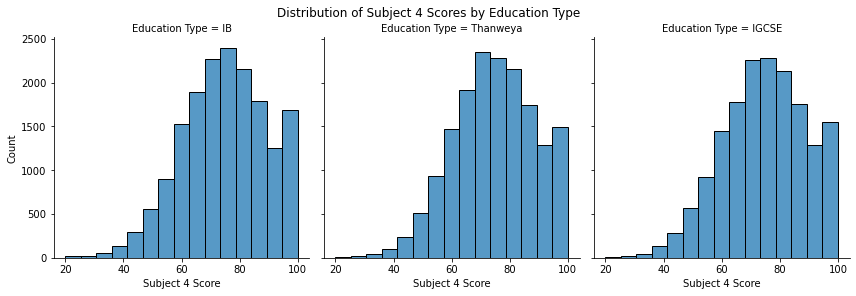

In [23]:
g = sns.FacetGrid(df, col="Education Type", height=4, aspect=1)
g.map(sns.histplot, "Subject_4", bins=15)
g.set_axis_labels('Subject 4 Score', 'Count')
g.fig.suptitle('Distribution of Subject 4 Scores by Education Type', y=1.02)
plt.show()

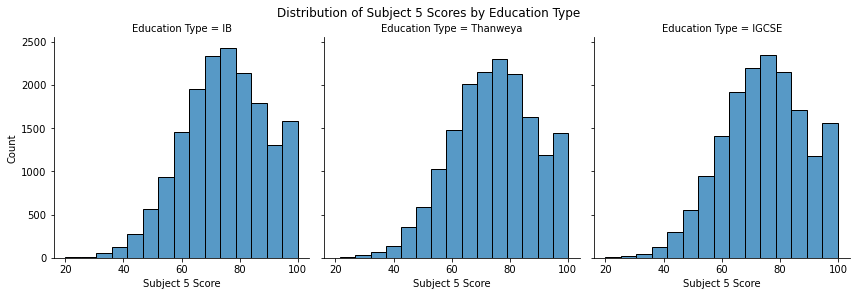

In [24]:
g = sns.FacetGrid(df, col="Education Type", height=4, aspect=1)
g.map(sns.histplot, "Subject_5", bins=15)
g.set_axis_labels('Subject 5 Score', 'Count')
g.fig.suptitle('Distribution of Subject 5 Scores by Education Type', y=1.02)
plt.show()

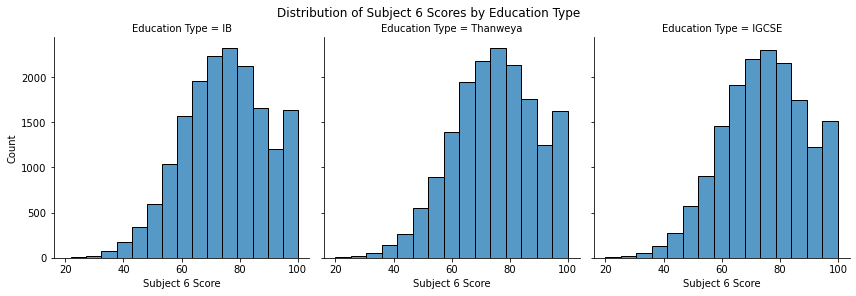

In [25]:
g = sns.FacetGrid(df, col="Education Type", height=4, aspect=1)
g.map(sns.histplot, "Subject_6", bins=15)
g.set_axis_labels('Subject 6 Score', 'Count')
g.fig.suptitle('Distribution of Subject 6 Scores by Education Type', y=1.02)
plt.show()

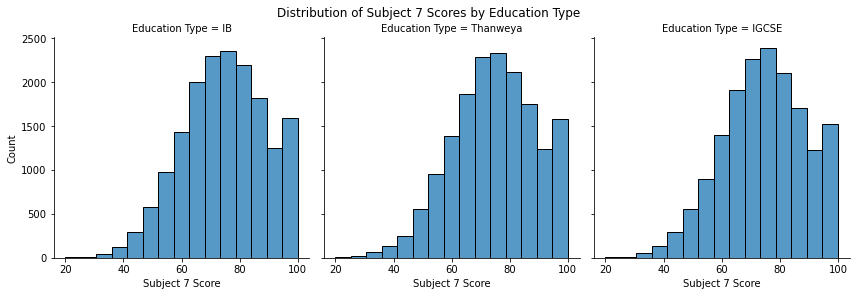

In [26]:
g = sns.FacetGrid(df, col="Education Type", height=4, aspect=1)
g.map(sns.histplot, "Subject_7", bins=15)
g.set_axis_labels('Subject 7 Score', 'Count')
g.fig.suptitle('Distribution of Subject 7 Scores by Education Type', y=1.02)
plt.show()

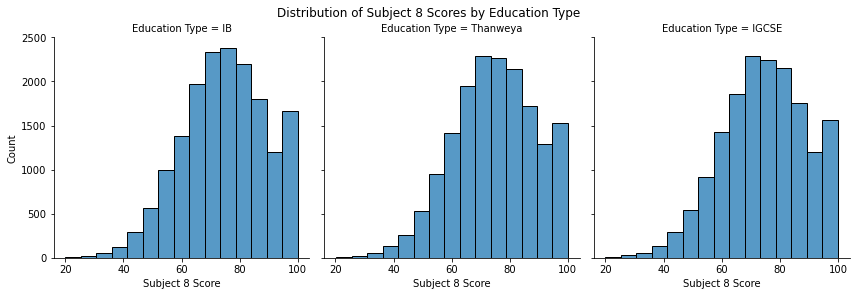

In [27]:
g = sns.FacetGrid(df, col="Education Type", height=4, aspect=1)
g.map(sns.histplot, "Subject_8", bins=15)
g.set_axis_labels('Subject 8 Score', 'Count')
g.fig.suptitle('Distribution of Subject 8 Scores by Education Type', y=1.02)
plt.show()

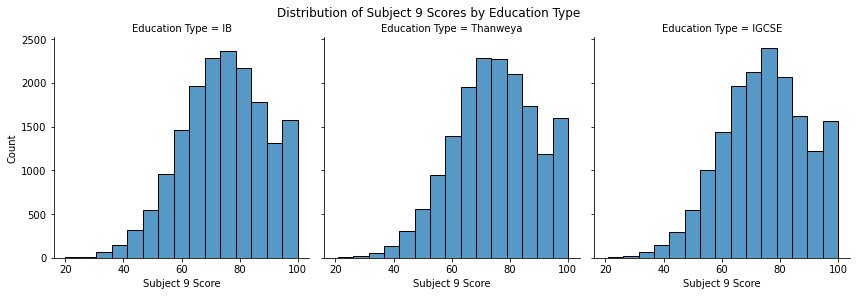

In [28]:
g = sns.FacetGrid(df, col="Education Type", height=4, aspect=1)
g.map(sns.histplot, "Subject_9", bins=15)
g.set_axis_labels('Subject 9 Score', 'Count')
g.fig.suptitle('Distribution of Subject 9 Scores by Education Type', y=1.02)
plt.show()

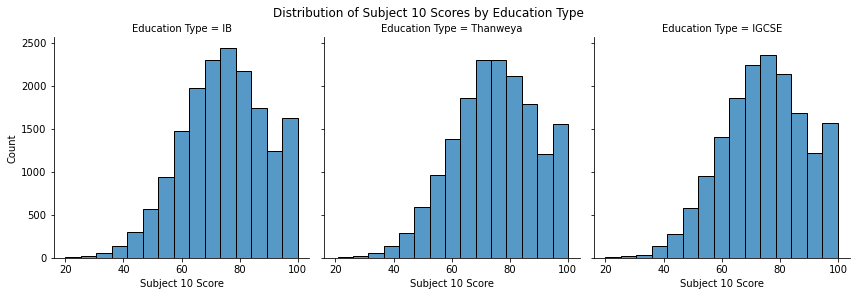

In [29]:
g = sns.FacetGrid(df, col="Education Type", height=4, aspect=1)
g.map(sns.histplot, "Subject_10", bins=15)
g.set_axis_labels('Subject 10 Score', 'Count')
g.fig.suptitle('Distribution of Subject 10 Scores by Education Type', y=1.02)
plt.show()